# Clustering para mejora de prestaciones

Estudiaremos si el clustering puede ayudar a la mejora de prestaciones para nuestro caso: **Predicción de partidos de fútbol**.

## Pasos a seguir

1. Utilizar un algoritmo de clustering para hacer grupos de variables con la matriz de covarianza. En teoría cada grupo tendrá variables que serán bastante parecidas (correladas) entre sí.
2. Ordenar las variables de cada grupo en función cómo correlan con la variable que queremos predecir.
3. Hacer todas las combinaciones de modelos de manera que para cada modelo se utilice una variable de cada grupo.
4. Ordenar todos los modelos por *accuracy* y hacer la elección.

## Importamos todas las dependencias necesarias

Utilizaremos **numpy** para el cálculo numérico, **pandas** para manipular los datos y **matplotlib** para visualizarlos. Con diferentes módulos de **sklearn** aplicaremos los algoritmos necesarios.

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn import preprocessing
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN

%matplotlib inline

## Recogida de los datos

Guardaremos en diferentes variables los datos que vamos a utilizar para hacer el clustering.

1. **matches** es la variable que guarda la información completa de los partidos, ya limpio de _NaN_ y _Nones_. Cuotas de apuestas, resultado y jugadores.
2. **ratings** es la variable que contiene los ratings de cada uno de los 22 jugadores en un partido. Cada fila es un partido y las columnas corresponden a los jugadores, 11 primeros de casa y los últimos 11 visitantes. El modelo no contempla los jugadores suplentes.

La variable **matches** la trataremos con pandas para sacar la información que nos es útil, en cambio **ratings** ya está anteriormente tratada en local y contiene ya la información que vamos a utilizar, por lo que se guardará como un numpy.array

In [2]:
matches = pd.read_csv('matches.csv')
ratings = np.array(pd.read_csv('ratings_global.csv'))

# Modelo 1

Primero utilizaremos un modelo muy simple, con las *features* reducidas, simplemente para visualizar ciertas cosas de una forma más cómoda. Tiraremos un poco de intuición, utilizando la suma de todos los *ratings* de los jugadores de un equipo, reduciendo de **22 posibles variables a 2** y teniendo una puntuación para cada equipo. Por otra parte no utilizaremos todas las cuotas de las casas de apuestas sino una media para cada posible resultado.

### Extracción y tratamiento de la información para cada partido

Nos quedamos con los datos que nos son de utilidad para hacer nuestra tarea, es decir, las cuotas de las casas de apuestas que hemos elegido, haciendo una media de ellas.

In [3]:
BetH = (matches.B365H + matches.BWH + matches.IWH + matches.LBH +
        matches.VCH + matches.WHH) / 6
BetD = (matches.B365D + matches.BWD + matches.IWD + matches.LBD +
        matches.VCD + matches.WHD) / 6
BetA = (matches.B365A + matches.BWA + matches.IWA + matches.LBA +
        matches.VCA + matches.WHA) / 6

### Creación del vector de características

Nuestro vector de características tendrá los ratings de cada equipo sumados y las diferentes cuotas (local, empate o visitante). Un modelo **muy simple con 5 features**.

In [4]:
home_team = np.sum(ratings[:, :11], axis=1).reshape(len(ratings), 1)
away_team = np.sum(ratings[:, 11:], axis=1).reshape(len(ratings), 1)

BetH = np.reshape(BetH, (len(matches), 1))
BetD = np.reshape(BetD, (len(matches), 1))
BetA = np.reshape(BetA, (len(matches), 1))

X = np.concatenate((home_team, away_team, BetH, BetD, BetA), axis=1)

### Resultados de los partidos

Calculamos las etiquetas de nuestro modelo, se trata de una quiniela, **1**, **X**, **2**, y lo hallamos con los goles de los partidos.

In [5]:
result = [None] * len(matches)
for i in range(len(matches)):
    result[i] = ("1" if matches.home_team_goal[i] > matches.away_team_goal[i] else "2" if matches.home_team_goal[i] < matches.away_team_goal[i] else "X")

y = np.array(result)

### Representaciones gráficas de los ratings respecto a los partidos

Nuestro modelo tiene 5 dimensiones por lo que no se puede visualizar directamente, por eso mostramos solo los ratings del equipo local frente a los del equipo visitante, coloreados según el signo de la quiniela, lo que al final es una forma de ver las 5 dimensiones en 1 sola. También podemos ver una proyección de las 5 variables en 2, siendo el eje X la diferencia entre los dos ratings de los equipos y el eje Y la probabilidad de ganar local o visitante (en el 0 estaría el empate).

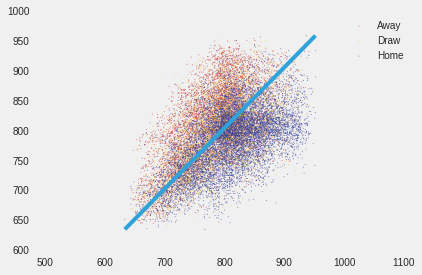

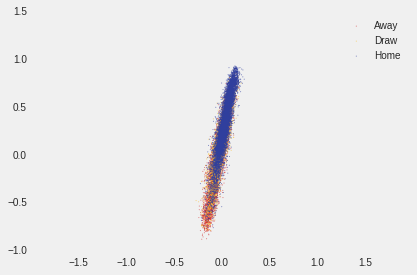

In [6]:
a = np.where(np.array(y) == '1')
b = np.where(np.array(y) == 'X')
c = np.where(np.array(y) == '2')

plt.style.use('fivethirtyeight')
scale = 1

plt.figure()
i = 0
j = 1
plt.plot([X[:, i].min(), X[:, i].max()], [X[:, j].min(), X[:, j].max()])
plt.scatter(X[c][:, i], X[c][:, j], c='#d32f2f', s=scale,
            label='Away', alpha=0.7, edgecolors='none')
plt.scatter(X[b][:, i], X[b][:, j], c='#fbc02d', s=scale,
            label='Draw', alpha=0.7, edgecolors='none')
plt.scatter(X[a][:, i], X[a][:, j], c='#303F9F', s=scale,
            label='Home', alpha=0.7, edgecolors='none')
plt.legend()
plt.grid()
plt.axis('equal')
plt.show(block=False)

X_ = np.concatenate(((home_team - away_team) / home_team, (1 / BetH - 1 / BetA)), axis=1)

plt.figure()
plt.scatter(X_[c][:, i], X_[c][:, j], c='#d32f2f', s=scale,
            label='Away', alpha=0.7, edgecolors='none')
plt.scatter(X_[b][:, i], X_[b][:, j], c='#fbc02d', s=scale,
            label='Draw', alpha=0.7, edgecolors='none')
plt.scatter(X_[a][:, i], X_[a][:, j], c='#303F9F', s=scale,
            label='Home', alpha=0.7, edgecolors='none')
plt.legend()
plt.grid()
plt.axis('equal')
plt.show(block=False)

### Escalado de las variables

Como los ratings de los equipos oscilan más o menos entre 600 y 1000 y, en cambio, las cuotas tienen unos valores más pequeños, tenemos que escalar las variables.

In [7]:
scaler = preprocessing.StandardScaler()
X = scaler.fit_transform(X)

## Clustering

Para el este modelo más simple se lo aplicaremos a los datos, ya que no tiene sentido utilizarlo con las _features_ ya que son muy pocas y luego no tendría sentido hacer la selección de variables con la salida del clustering.

Procedemos a agrupar por partidos aplicando los algoritmos que nos provee scikit-learn, en este caso **k-means** y **DBSCAN**, creamos además la matriz de covarianza para ver las correlaciones entre todos nuestros pares de variables, en el modelo más complejo será lo que utilicemos para hacer el clustering.

Este caso es un **clustering de instancias**, algo que puede ser de utilidad para otro estudio en otro momento, ya que trataría de forma diferente los grupos de partidos (los que sigan ciertos patrones), y podríamos aplicar los mismos procedimientos que en este notebook para sacar una predicción.

### Matriz de covarianza

Vamos a ver la similitud entre las variables, apoyándonos también de **seaborn**, con lo que visualizaremos una gráfica que nos ayudará a entenderlo mejor. La función que nos proporciona **seaborn**, *pairplot*, dibuja como son las distribuciones para cada par de variables, por lo que podemos ver las similitudes, además de un histograma de la variable en la diagonal.

,0,1,2,3,4
0,1.000,0.492,-0.271,0.382,0.491
1,0.492,1.000,0.456,-0.043,-0.264
2,-0.271,0.456,1.000,0.015,-0.485
3,0.382,-0.043,0.015,1.000,0.841
4,0.491,-0.264,-0.485,0.841,1.000


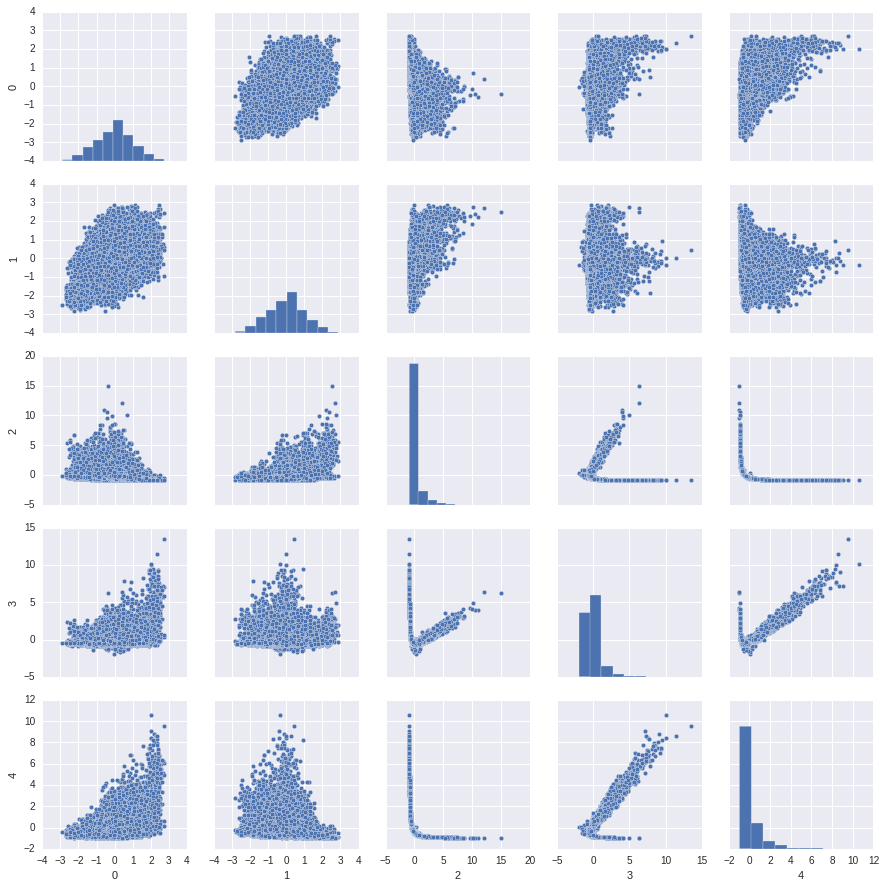

In [8]:
sns.set()
sns.pairplot(pd.DataFrame(X))

pd.DataFrame(np.around(np.cov(X, rowvar=0), decimals=3))

## K-means

Elegimos **k** para decirle al algoritmo cuantos en clusters queremos que nos divida los datos. Comienza colocando k *centroids* al azar (centros de cluster) y luego resuelve de forma iterativa hasta converger lo siguiente:

1. Asigna cada punto (dato) a su **centroide más cercano**, haciendole así miembro de ese cluster.
2. Calcula la **nueva posición del centroid**, calculando la posición media de todos los puntos que pertenecen a ese cluster.
3. Volver al paso 1 **si no ha convergido** (los puntos no cambian ni tampoco los *centroids*).

>Es el algoritmo de clustering más utilizado.

Sus *inputs* son **K** (número de clusters) y el training set **X**.

In [9]:
%%HTML
<iframe width="560" height="315" src="https://www.youtube.com/embed/-J9ZICyev5E" frameborder="0" allowfullscreen></iframe>

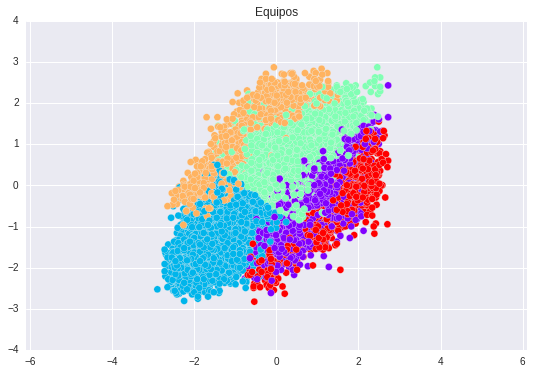

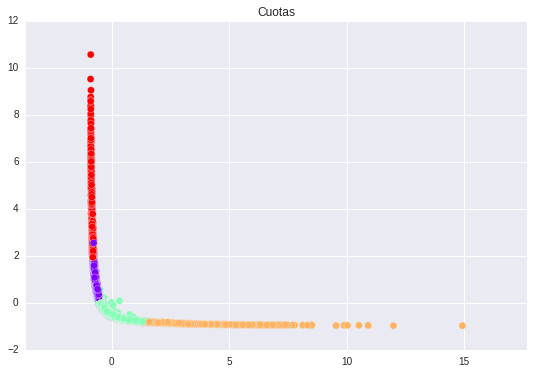

In [10]:
kmeans = KMeans(random_state=0, init='k-means++', n_clusters=5, n_init=10).fit(X)
y_kmeans = kmeans.predict(X)
plt.scatter(X[:, 0], X[:, 1], c=y_kmeans, s=50, cmap='rainbow');
plt.axis('equal')
plt.title('Equipos')
plt.show()
plt.scatter(X[:, 2], X[:, 4], c=y_kmeans, s=50, cmap='rainbow');
plt.axis('equal')
plt.title('Cuotas')
plt.show()

## DBSCAN

K-means no es siempre la mejor opción para el clustering, sobretodo cuando los datos dibujan ciertas formas, y una de las alternativas son los **algoritmos de clustering basados en densidades**. Los algoritmos que se basan en la densidad tienen como premisa que todos los datos están dibujados con una función de densidad de probabilidad, por lo que utilizar una estimación de esa función debería darnos muy buenos resultados.

Comparado con k-means, un algoritmo teórico basado en densidades tiene diferentes pros y contras:

### Pros

- Podemos detectar formas mucho más complejas en los datos.
- No necesitamos saber **k** (número de clusters).
- Automaticamente encontramos los *outliers*.

### Contras

- Requiere una función de distancia.
- No es tan escalable como k-means.
- Es imposible en la práctica, ya que no se puede computar todos los componentes topologicamente conectados.

Por tanto un algoritmo perfecto basado en densidad no existe, pero DBSCAN intenta aproximarse. Lo que hace DBSCAN es dividir los datos de nuestro conjunto en tres tipos: **core**, **boundary** y **noise**.

El algoritmo busca los **core points**, que son los puntos que tienen la mayor densidad, están rodeados de una mayor cantidad de puntos y serán el centro de los clusters. Visita todos los puntos hasta llegar a los **boundary points** y luego pasa a otro cluster. Los *outliers* son considerados como **noise** y no los categoriza en ningún cluster.

Como entrada tiene **epsilon**, que mide la distancia máxima en la que se buscarán vecinos y **min_samples**, variable que nos dice el minimo número de vecinos para considerar a un punto dentro de un cluster. 

[DBSCAN visualization](https://www.naftaliharris.com/blog/visualizing-dbscan-clustering/ "DBSCAN visualization")

> Es el algoritmo de clustering basado en densidades más utilizado

In [11]:
%%HTML
<iframe width="560" height="315" src="https://www.youtube.com/embed/5cOhL4B5waU" frameborder="0" allowfullscreen></iframe>

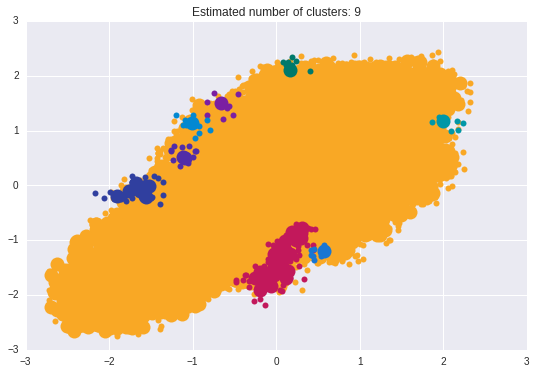

In [12]:
db = DBSCAN(eps=0.3, min_samples=10).fit(X)
core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)

# Black removed and is used for noise instead.
unique_labels = set(labels)
colors = ['#F9A825', '#C2185B', '#7B1FA2', '#512DA8', '#303F9F', '#1976D2', '#0288D1', '#0097A7', '#00796B']
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Black used for noise.
        col = 'black'

    class_member_mask = (labels == k)

    xy = X[class_member_mask & core_samples_mask]
    plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=col,
             markeredgecolor='k', markersize=14)

    xy = X[class_member_mask & ~core_samples_mask]
    plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=col,
             markeredgecolor='k', markersize=6)

plt.title('Estimated number of clusters: %d' % n_clusters_)
plt.show()

# Modelo 2

En este modelo ampliaremos el uso de *features*, para poder aplicar el clustering a la matriz de covarianza y ver en que grupos se dividen las variables y hacer la selección. Veremos como de buena era nuestra intuición de sumar todos los ratings globales de un jugador y de hacer una media de las cuotas de las casas de apuestas.

### Extracción y tratamiento de la información para cada partido

Esta vez utilizaremos más columnas para nuestra matriz de partidos. Adentrándonos en la base de datos vemos que podemos utilizar **atributos de cada equipo**, así como *ratings* de los jugadores en **facetas del juego más concretas**. En vez del rating global utilizar puntuación de *regate*, *definición*, *pase*... 

Nos encontramos con un problema en nuestro dataset, a la tabla de **Team_Attributes** le falta mucha información de *BuildUpDribbling*, más de un **66%**, lo que nos limitaría muchísimo el número de partidos que tenemos. Pero esto es algo común y la solución es no utilizar dicha culumna, por lo que a priori ese problema no nos supondría demasiados daños.

Problema 2, dentro de la tabla **Team_Attributes**, al hacernos un pequeño código de Python para mapear cada atributo a su correspondiente equipo-partido, vemos que hay muchos que tienen una fecha posterior a la fecha del mismo, por lo que tampoco podríamos utilizarlo. Si fuera un problema minoritario aplicariamos lo mismo que para la columna que nos daba problemas pero en filas, pero son más de un **75%** de los partidos, totalmente inviable.

Por tanto, la información en conjunto de los equipos sacrifica demasiado nuestro número de partidos del dataset y no parece que sea una opción viable. No podremos alimentar a nuestro modelo con lo ofensivo o defensivo que es un equipo, quizás en una futura versión de la base de datos sea posible.

Atacamos entonces el apartado de jugadores, donde tenemos problemas similares al de *BuildUpDribbling* con varias columnas:

- *sliding_tackle*
- *vision*
- *jumping*
- *balance*
- *agility*
- *curve*
- *volleys*
- *attacking_work_rate*

Por tanto, estos atributos los desechamos desde un principio, ya que hemos visto que no vale la pena, nos quita un porcentaje de nuestro *dataset* demasiado elevado. Una vez eliminadas esas características, tenemos para elegir entre una larga lista de variables:

- *height*
- *weight*
- *overall_rating*
- *potential*
- *crossing*
- *finishing*
- *heading_accuracy*
- *short_passing*
- *dribbling*
- *free_kick_accuracy*
- *long_passing*
- *ball_control*
- *acceleration*
- *sprint_speed*
- *reactions*
- *shot_power*
- *stamina*
- *strength*
- *aggression*
- *interceptions*
- *positioning*
- *penalties*
- *marking*
- *standing_tackle*
- *gk_diving*
- *gk_handling*
- *gk_kicking*
- *gk_positioning*
- *gk_reflexes*

Cogerlas todas podría parecer lo más fácil, pero se nos va a **638** (29 variables por 22 jugadores) *features* para nuestro modelo **con solo la información de los jugadores**. Un modelo quizás demasiado complicado para la tarea que estamos intentando probar, se lo dejaremos a *TensorFlow* más adelante, ya que quizás con *deep learning* si que puede salir algo interesante de ahí.

Además se nos une la **tarea del mapeo**, la cual depende de las fechas de los atributos de los jugadores y de la fecha en la que se jugó el partido, por tanto vamos a utilizar las mismas variables del modelo 1 pero extendiéndolas, es decir, un *rating* para cada jugador y las 6 casas de apuestas con sus respectivas cuotas cada una (tendrán una gran correlación). Gracias a esta simple expansión tenemos ya disponible un vector **X** de 40 variables con las que, ahora sí, tiene sentido aplicar nuestro estudio.

Al utilizar las mismas variables que en el modelo 1 pero extendidas podremos, además, **medir como de buena era nuestra intuición de reducción de la dimensionalidad**.

In [13]:
betH = np.array([matches.B365H, matches.BWH, matches.IWH, matches.LBH, matches.VCH, matches.WHH])
betH = np.transpose(betH)
betD = np.array([matches.B365D, matches.BWD, matches.IWD, matches.LBD, matches.VCD, matches.WHD])
betD = np.transpose(betD)
betA = np.array([matches.B365A, matches.BWA, matches.IWA, matches.LBA, matches.VCA, matches.WHA])
betA = np.transpose(betA)

X = np.concatenate((ratings, betH, betD, betA), axis=1)

## Escalado de variables

Procedemos a escalar las variables para que se puedan utilizar de forma correcta ya que tenemos el mismo problema que en el modelo 1.

In [14]:
scaler = preprocessing.StandardScaler()
X_scaler = scaler.fit_transform(X)

## Clustering

Pasamos al *clustering*, el cual vamos a aplicar esta vez a la matriz de covarianza de nuestras 40 variables. Primero visualizamos la correlación entre nuestras variables en la siguiente matriz.

In [15]:
sns.set()
sns.pairplot(pd.DataFrame(X_scaler))

cov_matrix = pd.DataFrame(np.around(np.cov(X_scaler, rowvar=0), decimals=3))

## K-means

Ya explicamos como funcionaba este famoso algoritmo de *clustering* para el modelo 1, la diferencia es que para el anterior modelo se lo aplicamos a los datos, como si se tratara de un problema completo de *aprendizaje no supervisado* y ahora lo vamos a aplicar a nuestra matriz de covarianza, para que saque grupos de variables que sigan unos patrones parecidos (correladas).

> Aplicamos el método del codo para saber cual es el valor óptimo de k y luego lo aplicamos.

En el método del codo parece que el mejor valor es 4, pero viendo para que variables agrupaba el algoritmo hemos decidido elegir **k = 5**. La respuesta es muy sencilla, con k = 5 el algoritmo agrupa los 11 jugadores del equipo local, los 11 del equipo visitante y un grupo por cada posible resultado de quiniela en las cuotas. 

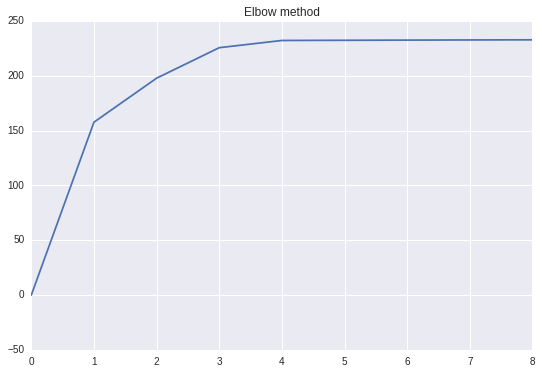

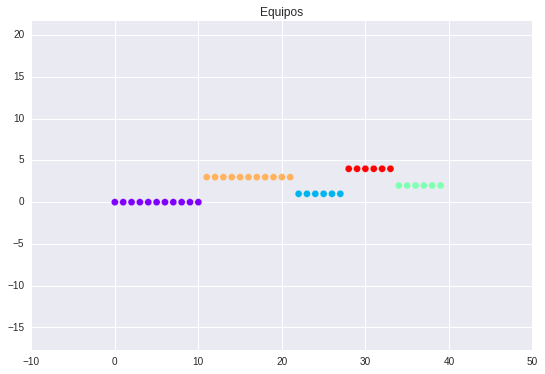

In [16]:
from scipy.spatial.distance import cdist
from scipy.spatial.distance import pdist

kMeansVar = [KMeans(n_clusters=k).fit(cov_matrix.values) for k in range(1, 10)]
centroids = [a.cluster_centers_ for a in kMeansVar]
k_euclid = [cdist(cov_matrix.values, cent) for cent in centroids]
dist = [np.min(ke, axis=1) for ke in k_euclid]
wcss = [sum(d**2) for d in dist]
tss = sum(pdist(cov_matrix.values)**2)/cov_matrix.values.shape[0]
bss = tss - wcss
plt.plot(bss)
plt.title('Elbow method')
plt.show()

kmeans = KMeans(random_state=0, init='k-means++', n_clusters=5, n_init=10).fit(cov_matrix)
y_kmeans = kmeans.predict(cov_matrix)

plt.scatter(np.arange(40), y_kmeans, c=y_kmeans, s=50, cmap='rainbow');
plt.axis('equal')
plt.title('Equipos')
plt.show()

## DBSCAN

Al igual que con **k-means**, ya hemos explicado el funcionamiento interno de este algoritmo de clustering basado en densidades. Procedemos a sacar los grupos de variables.

Jugamos con los parámetros **eps**, que nos dice la distancia máxima que debe de haber entre dos puntos para poder pertenecer al mismo cluster, y **min_samples**, con la que controlamos el mínimo de vecinos para que un punto sea considerado dentro de un cluster.

Damos con una división en **grupos de variables exactamente igual que la de k-means**, donde forman un grupo diferente los 11 jugadores de cada equipo y cada cuota diferenciada por signode la quiniela.

De momento parece que nuestra estrategia del modelo 1 puede ser bastante buena, ya que lo que hicimos es sumar las variables dentro de los *clusters* de jugadores y hacer la media de cada uno de los *clusters* de cuotas.

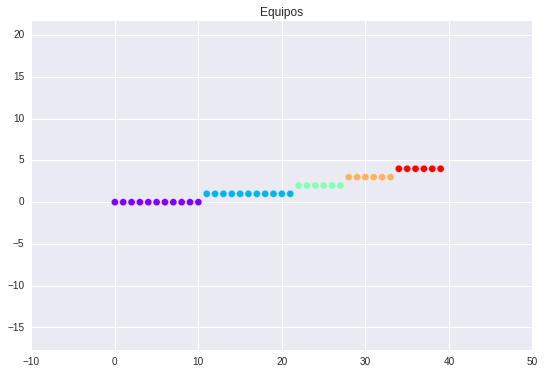

In [17]:
db = DBSCAN(eps=0.6, min_samples=5).fit(cov_matrix)
core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)

# Black removed and is used for noise instead.
unique_labels = set(labels)

plt.scatter(np.arange(40), labels, c=labels, s=50, cmap='rainbow');
plt.axis('equal')
plt.title('Equipos')
plt.show()

## Selección de variables

Vamos a utilizar **univariate feature selection** y **tree-based feature selection** para realizar la selección de variables para cada cluster. Nos proporciona todos estos módulos *scikit-learn*. Aplicamos las variables ya escaladas, si no la selección estaría corrupta.

Primero nos quedamos con los diferentes vectores de entrada para cada cluster, donde dividiremos tal cual nos ha devuelto **k-means** y **DBSCAN**.

In [18]:
X_1 = X[:,:11]
X_2 = X[:, 11:22]
X_3 = X[:, 22:28]
X_4 = X[:, 28:34]
X_5 = X[:, 34:40]

### Univariate Feature Selection

Seleccionaremos **k** para decirle al algoritmo con cuantas dimensiones nos queremos quedar, como queremos un modelo muy simple elegiremos 1.

In [19]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2

X_new_1 = SelectKBest(chi2, k=1).fit_transform(X_1, y)
X_new_2 = SelectKBest(chi2, k=1).fit_transform(X_2, y)
X_new_3 = SelectKBest(chi2, k=1).fit_transform(X_3, y)
X_new_4 = SelectKBest(chi2, k=1).fit_transform(X_4, y)
X_new_5 = SelectKBest(chi2, k=1).fit_transform(X_5, y)

### Tree-based Feature Selection

Aplica un arbol como modelo y se queda con las variables más importantes, reduciendo la dimensionalidad. Aplicamos el algoritmo hasta que tengamos una única variable.

In [20]:
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.feature_selection import SelectFromModel

X_sel_1 = X_1
X_sel_2 = X_2
X_sel_3 = X_3
X_sel_4 = X_4
X_sel_5 = X_5

clf = ExtraTreesClassifier()
while X_sel_1.shape[1] != 1:
    clf = clf.fit(X_sel_1, y)
    model = SelectFromModel(clf, prefit=True)
    X_sel_1 = model.transform(X_sel_1)

while X_sel_2.shape[1] != 1:
    clf = clf.fit(X_sel_2, y)
    model = SelectFromModel(clf, prefit=True)
    X_sel_2 = model.transform(X_sel_2)
    
while X_sel_3.shape[1] != 1:
    clf = clf.fit(X_sel_3, y)
    model = SelectFromModel(clf, prefit=True)
    X_sel_3 = model.transform(X_sel_3)
    
while X_sel_4.shape[1] != 1:
    clf = clf.fit(X_sel_4, y)
    model = SelectFromModel(clf, prefit=True)
    X_sel_4 = model.transform(X_sel_4)
    
while X_sel_5.shape[1] != 1:
    clf = clf.fit(X_sel_5, y)
    model = SelectFromModel(clf, prefit=True)
    X_sel_5 = model.transform(X_sel_5)

## Aplicamos modelos

Ahora que tenemos las mejores variables de cada grupo, procederemos a aplicar un modelo para cada una de ellas. Tomaremos los dos caminos posibles, el de **Univariate Feature Selection** y el de **Tree-based Feature Selection**, después eligiremos el que mejor rinda y desecharemos el otro.

Vamos a visualizar las diferentes distribuciones de nuestras variables.

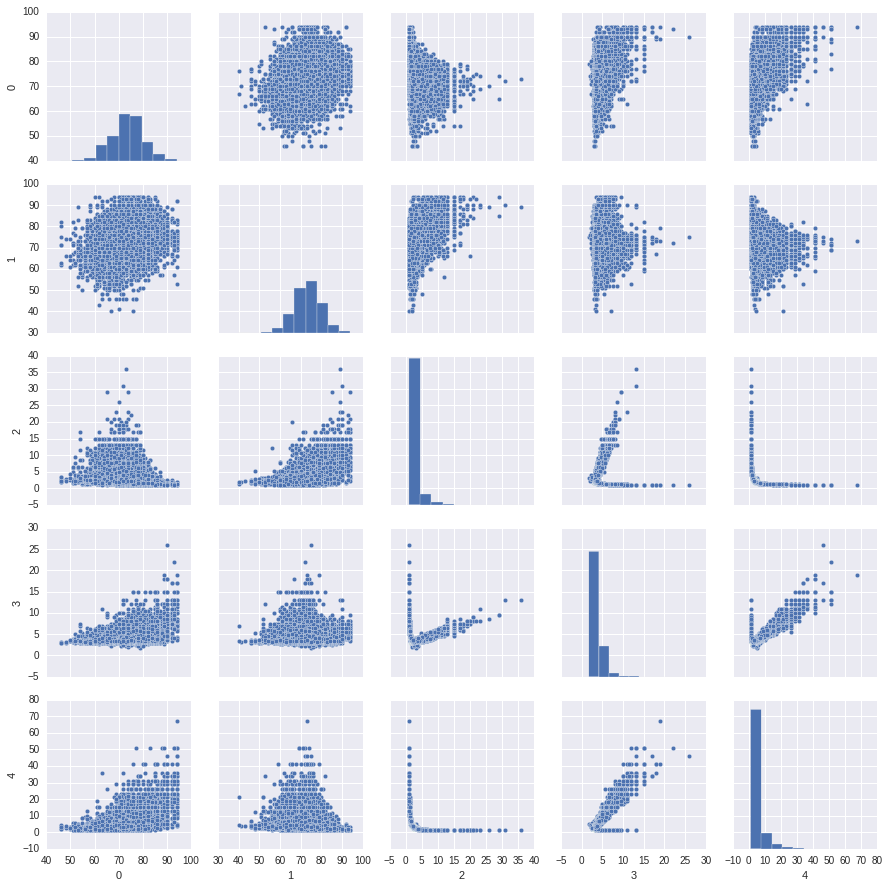

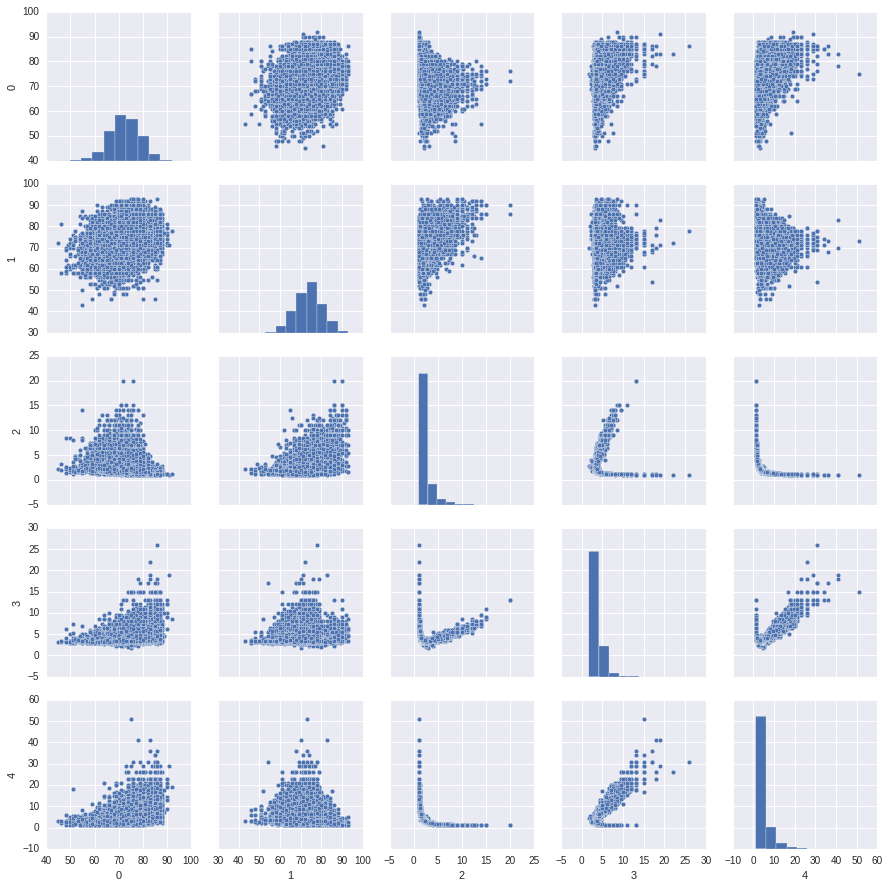

In [21]:
sns.set()
sns.pairplot(pd.DataFrame(np.concatenate((X_new_1, X_new_2, X_new_3, X_new_4, X_new_5), axis=1)))

sns.set()
sns.pairplot(pd.DataFrame(np.concatenate((X_sel_1, X_sel_2, X_sel_3, X_sel_4, X_sel_5), axis=1)))

### Separación de los datos para que no haya *overfitting*

Separamos para cada uno de los modelos simples para evitar el **overfitting** y que generalicen bien paran nuevos datos. Para la validación utilizaremos la técnica de la validación cruzada y después compararemos todas las precisiones para ver con que modelos nos quedamos.

In [22]:
from sklearn import linear_model
from sklearn import tree
from sklearn.model_selection import train_test_split
from sklearn.model_selection import ShuffleSplit
from sklearn.model_selection import cross_val_score

X_train_1_1, X_test_1_1, y_train_1_1, y_test_1_1 = train_test_split(X_new_1, y, test_size=0.3, random_state=1)
X_train_1_2, X_test_1_2, y_train_1_2, y_test_1_2 = train_test_split(X_new_2, y, test_size=0.3, random_state=1)
X_train_1_3, X_test_1_3, y_train_1_3, y_test_1_3 = train_test_split(X_new_3, y, test_size=0.3, random_state=1)
X_train_1_4, X_test_1_4, y_train_1_4, y_test_1_4 = train_test_split(X_new_4, y, test_size=0.3, random_state=1)
X_train_1_5, X_test_1_5, y_train_1_5, y_test_1_5 = train_test_split(X_new_5, y, test_size=0.3, random_state=1)
X_train_2_1, X_test_2_1, y_train_2_1, y_test_2_1 = train_test_split(X_sel_1, y, test_size=0.3, random_state=2)
X_train_2_2, X_test_2_2, y_train_2_2, y_test_2_2 = train_test_split(X_sel_2, y, test_size=0.3, random_state=2)
X_train_2_3, X_test_2_3, y_train_2_3, y_test_2_3 = train_test_split(X_sel_3, y, test_size=0.3, random_state=2)
X_train_2_4, X_test_2_4, y_train_2_4, y_test_2_4 = train_test_split(X_sel_4, y, test_size=0.3, random_state=2)
X_train_2_5, X_test_2_5, y_train_2_5, y_test_2_5 = train_test_split(X_sel_5, y, test_size=0.3, random_state=2)

cv = ShuffleSplit(n_splits=3, test_size=0.3, random_state=0)

accuracies_log = []
accuracies_tree = []

### Regresión logística

Vamos a aplicar regresión logística como modelo para cada una de las variables seleccionadas de los grupos.

In [23]:
clf_log = linear_model.LogisticRegression()

clf_log.fit(X_train_1_1, y_train_1_1)
accuracies_log.append(cross_val_score(clf_log, X, y, cv=cv, scoring='accuracy'))
clf_log.fit(X_train_1_2, y_train_1_2)
accuracies_log.append(cross_val_score(clf_log, X, y, cv=cv, scoring='accuracy'))
clf_log.fit(X_train_1_3, y_train_1_3)
accuracies_log.append(cross_val_score(clf_log, X, y, cv=cv, scoring='accuracy'))
clf_log.fit(X_train_1_4, y_train_1_4)
accuracies_log.append(cross_val_score(clf_log, X, y, cv=cv, scoring='accuracy'))
clf_log.fit(X_train_1_5, y_train_1_5)
accuracies_log.append(cross_val_score(clf_log, X, y, cv=cv, scoring='accuracy'))
clf_log.fit(X_train_2_1, y_train_2_1)
accuracies_log.append(cross_val_score(clf_log, X, y, cv=cv, scoring='accuracy'))
clf_log.fit(X_train_2_2, y_train_2_2)
accuracies_log.append(cross_val_score(clf_log, X, y, cv=cv, scoring='accuracy'))
clf_log.fit(X_train_2_3, y_train_2_3)
accuracies_log.append(cross_val_score(clf_log, X, y, cv=cv, scoring='accuracy'))
clf_log.fit(X_train_2_4, y_train_2_4)
accuracies_log.append(cross_val_score(clf_log, X, y, cv=cv, scoring='accuracy'))
clf_log.fit(X_train_2_5, y_train_2_5)
accuracies_log.append(cross_val_score(clf_log, X, y, cv=cv, scoring='accuracy'))

### Árbol de decisión

Como segunda opción aplicaremos un árbol de decisión como modelo para cada subconjunto.

In [24]:
clf_tree = tree.DecisionTreeClassifier()

clf_tree.fit(X_train_1_1, y_train_1_1)
accuracies_tree.append(cross_val_score(clf_tree, X, y, cv=cv, scoring='accuracy'))
clf_tree.fit(X_train_1_2, y_train_1_2)
accuracies_tree.append(cross_val_score(clf_tree, X, y, cv=cv, scoring='accuracy'))
clf_tree.fit(X_train_1_3, y_train_1_3)
accuracies_tree.append(cross_val_score(clf_tree, X, y, cv=cv, scoring='accuracy'))
clf_tree.fit(X_train_1_4, y_train_1_4)
accuracies_tree.append(cross_val_score(clf_tree, X, y, cv=cv, scoring='accuracy'))
clf_tree.fit(X_train_1_5, y_train_1_5)
accuracies_tree.append(cross_val_score(clf_tree, X, y, cv=cv, scoring='accuracy'))
clf_tree.fit(X_train_2_1, y_train_2_1)
accuracies_tree.append(cross_val_score(clf_tree, X, y, cv=cv, scoring='accuracy'))
clf_tree.fit(X_train_2_2, y_train_2_2)
accuracies_tree.append(cross_val_score(clf_tree, X, y, cv=cv, scoring='accuracy'))
clf_tree.fit(X_train_2_3, y_train_2_3)
accuracies_tree.append(cross_val_score(clf_tree, X, y, cv=cv, scoring='accuracy'))
clf_tree.fit(X_train_2_4, y_train_2_4)
accuracies_tree.append(cross_val_score(clf_tree, X, y, cv=cv, scoring='accuracy'))
clf_tree.fit(X_train_2_5, y_train_2_5)
accuracies_tree.append(cross_val_score(clf_tree, X, y, cv=cv, scoring='accuracy'))

### Comparación de modelos

Ahora comparamos ambos modelos a ver cual nos da una precisión mayor. Vemos que la **regresión logística** "gana" para todos los casos, por tanto usaremos ese modelo para nuestro estudio. La regresión logística se impone en los dos tipos de modelos que hemos aplicado según nuestros dos algoritmos de selección de variables.

In [25]:
accuracies_log_mean = []
accuracies_tree_mean = []

for accuracy_log in accuracies_log:
    accuracies_log_mean.append(np.mean(accuracy_log))

for accuracy_tree in accuracies_tree:
    accuracies_tree_mean.append(np.mean(accuracy_tree))

### Ensemble methods

Ahora que ya tenemos los 10 modelos que vamos a utilizar (5 para cada camino), podemos aplicar los *ensemble methods* que combinarán los 5 modelos y sacarán la predicción final.

Este es el último paso para sacar conclusiones acerca de nuestro estudio, gracias a este paso podremos combinar todos los modelos, además de contar con las ventajas de los *ensemble methods*, como por ejemplo **reducir la varianza** y hacer una **media del sesgo** de nuestros estimadores. Por tanto el resultado será una predicción que **dificilmente estará sobrestimada**, por lo que podrá generalizar bien para nuevos datos de entrada.

In [26]:
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import VotingClassifier

X_1 = np.concatenate((X_train_1_1, X_train_1_2, X_train_1_3, X_train_1_4, X_train_1_5), axis=1)
X_2 = np.concatenate((X_train_2_1, X_train_2_2, X_train_2_3, X_train_2_4, X_train_2_5), axis=1)
Y_1 = y_train_1_1
Y_2 = y_train_2_1

clf1 = linear_model.LogisticRegression(random_state=1)
clf2 = RandomForestClassifier(random_state=1)
clf3 = GaussianNB()

eclf = VotingClassifier(estimators=[('lr', clf1), ('rf', clf2), ('gnb', clf3)], voting='hard')

print "-------------------------------------------------------------------------------------------------"

for clf, label in zip([clf1, clf2, clf3, eclf], ['Logistic Regression', 'Random Forest', 'naive Bayes', 'Ensemble']):
    scores = cross_val_score(clf, X_1, Y_1, cv=5, scoring='accuracy')
    print("Accuracy: %0.2f (+/- %0.2f) [%s]" % (scores.mean(), scores.std(), label))

print "-------------------------------------------------------------------------------------------------"

for clf, label in zip([clf1, clf2, clf3, eclf], ['Logistic Regression', 'Random Forest', 'naive Bayes', 'Ensemble']):
    scores = cross_val_score(clf, X_2, Y_2, cv=5, scoring='accuracy')
    print("Accuracy: %0.2f (+/- %0.2f) [%s]" % (scores.mean(), scores.std(), label))

-------------------------------------------------------------------------------------------------
Accuracy: 0.53 (+/- 0.00) [Logistic Regression]
Accuracy: 0.47 (+/- 0.01) [Random Forest]
Accuracy: 0.45 (+/- 0.01) [naive Bayes]
Accuracy: 0.52 (+/- 0.01) [Ensemble]
-------------------------------------------------------------------------------------------------
Accuracy: 0.53 (+/- 0.00) [Logistic Regression]
Accuracy: 0.47 (+/- 0.00) [Random Forest]
Accuracy: 0.46 (+/- 0.01) [naive Bayes]
Accuracy: 0.51 (+/- 0.01) [Ensemble]


## Conclusiones finales

Lamentablemente los *ensemble methods* no parecen mejorar la precisión, ya que la regresión logística parece batirle en todas las ocasiones y en los dos caminos que hemos elegido. Además, ambos caminos tienen una precisión prácticamente igual, de hecho en el caso de la regresión logística es la misma, pero un poco mejor en el caso donde hicimos *feature selection* con *univariate feature selection*, ya que tiene menor varianza.

Lo bueno es que este modelo tan simple, donde hemos podido aprender muchos aspectos del machine learning como **clustering**, **feature selection** o **ensemble methods**, comparándolo con **el modelo de regresión logística para todas las variables de entrada mejora la precisión**, por tanto acabamos visualizando la precisión del modelo con todas las variables, para confirmar que, a veces, lo simple es mejor.

In [27]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1)

clf1 = clf1.fit(X_train, y_train)
print (cross_val_score(clf, X, y, cv=5, scoring='accuracy')).mean()

0.51505304343


## Extra

Como punto final vamos a contestar algunas preguntas que pueden ser interesantes para el estudio del modelo.

  - **¿Cuáles son las variables elegidas con los dos métodos? (Tienen sentido esas selecciones o en qué coinciden).**


  - **¿Qué pasa si hacemos los métodos de selección de variables sin hacer el clústering? Es decir, partir de todas las variables a ver si eligen las mismas 5 o si mejoran la precisión del modelo final.**
  
### ¿Cuáles son las variables elegidas con los dos métodos?

Hay que fijarse en cada par de variables de la lista *variables*, para hacerlo más facil lo convertimos en un *numpy.array* y le hacemos un *reshape*. La selección ha elegido de forma diferente para todas las variables, y hay un par de datos curiosos.

- El primer algoritmo de **feature selection**, a elegido como variables más importantes para ambos equipos la décima columna, lo que tiene bastante sentido porque es uno de los atacantes (los equipos están ordenados, el 0 es el portero de casa y el 11 el del equipo visitante). Como dato curioso **Lionel Messi** suele jugar en la posición 10. En cambio el segundo algoritmo de selección de variables ha elegido las **posiciones 6 y 7**, donde juegan jugadores con el rol de centrocampista.
- A la hora de elegir las cuotas, el algoritmo 1, basa su elección tanto para "gana equipo local", "empate" o "gana equipo visitante" en la columna 5 (VC), o lo que es lo mismo, la casa de apuestas **VC Bet**. Por el contrario, el modelo 2 no se fía siempre de la misma casa y apuesta por la columna 4, más conocida como **Sportium** para apostar por el equipo local y por la segunda para el empate y la victoria visitante, la archiconocida **Bet&Win**

A priori parece que ambas selecciones pueden tener sentido y no hay ningún elemento que parezca romper con la lógica, por ejemplo que se basaran en la puntuación del portero.

In [28]:
variables = []

for X_aux in [X_new_1, X_sel_1]:
    for i in range(11):
        aux = X[:,:11][:,i].T
        aux = np.reshape(aux, (19567, 1))
        if (aux == X_aux).all() == True:
            variables.append(i)
            break
            
for X_aux in [X_new_2, X_sel_2]:
    for i in range(11):
        aux = X[:, 11:22][:,i].T
        aux = np.reshape(aux, (19567, 1))
        if (aux == X_aux).all() == True:
            variables.append(i)
            break
            
for X_aux in [X_new_3, X_sel_3]:
    for i in range(6):
        aux = X[:, 22:28][:,i].T
        aux = np.reshape(aux, (19567, 1))
        if (aux == X_aux).all() == True:
            variables.append(i)
            break
            
for X_aux in [X_new_4, X_sel_4]:
    for i in range(6):
        aux = X[:, 28:34][:,i].T
        aux = np.reshape(aux, (19567, 1))
        if (aux == X_aux).all() == True:
            variables.append(i)
            break
            
for X_aux in [X_new_5, X_sel_5]:
    for i in range(6):
        aux = X[:, 34:40][:,i].T
        aux = np.reshape(aux, (19567, 1))
        if (aux == X_aux).all() == True:
            variables.append(i)
            break
            
print np.reshape(np.array(variables), (5, 2))

[[ 9  6]
 [ 9 10]
 [ 4  2]
 [ 4  4]
 [ 4  1]]


### ¿Qué pasa si hacemos los métodos de selección de variables sin hacer el clústering?

Vamos a ver en cuanto difiere hacer la selección sin el paso del *clustering*. Para el método de *univariate feature selection* podemos obligarle a que sean 5 las variables para ver si coinciden, por lo que será lo que haremos. Para el segundo método también se puede obligar haciendo algo similar a los *while* que aplicamos antes pero para 5 variables, pero no lo vamos a hacer para intentar que nos de su mejor elección posible.

El primer modelo, *univariate feature selection*, selecciona como las 5 mejores variables las últimas 5 cuotas de las casas de apuestas, lo que quiere decir que solo le interesa la información sobre las casas de apuestas para el caso de "gana equipo visitante", concretamente todas las cuotas excepto la de **Bet365**. Probando a subirle el número de features, con 6 elige todas las cuotas de visitante, y si subimos a 7 elige una de las de ganar, por lo que parece que **apuesta por las casas profesionales antes que por los datos que tenemos sobre los jugadores**.

El segundo modelo distinto, aunque si nos fijamos bien no tanto. **Coincide con el primer algoritmo en elegir las cuotas de victoria local y visitante**, aunque si le obligamos a coger como máximo 6 *features* no elige las cuotas siempre. Para esta segunda forma si que son importantes los datos de los partidos y, aunque para cada vez que se ejecute cambia de *features*, suele ser bastante parecido. Tiene en cuenta cuotas de local y visitante (la del empate no, y tiene lógica porque ya hemos visto que predecir un empate es casi imposible), además de algún centrocampista o delantero de cada equipo.

In [29]:
# univariate feature selection
X_new = SelectKBest(chi2, k=5).fit_transform(X, y)
    
# tree-based feature selection
clf = ExtraTreesClassifier()
clf = clf.fit(X, y)
model = SelectFromModel(clf, prefit=True)
X_sel = model.transform(X)

print X_new.shape
print X_sel.shape

univariate_variables = []
tree_variables = []


for index, X_ in enumerate(X.T):
    for X_new_ in X_new.T:
        if (np.array_equal(X_, X_new_)):
            univariate_variables.append(index) 
            break
            
for index, X_ in enumerate(X.T):
    for X_sel_ in X_sel.T:
        if (np.array_equal(X_, X_sel_)):
            tree_variables.append(index) 
            break
            
print univariate_variables
print tree_variables

(19567, 5)
(19567, 13)
[34, 35, 37, 38, 39]
[3, 22, 23, 24, 25, 26, 27, 34, 35, 36, 37, 38, 39]


### Precisión sin paso previo del *clustering*

Aplicamos el *ensemble* para estos vectores y nos sale realmente parecido a lo de antes. El modelo 1 parece que es un poquito peor ahora, y el modelo 2 mejora minimamente respecto al que tenía en cuenta el clustering.

In [30]:
X_train_1, X_test_1, y_train_1, y_test_1 = train_test_split(X_new, y, test_size=0.3, random_state=1)
X_train_2, X_test_2, y_train_2, y_test_2 = train_test_split(X_sel, y, test_size=0.3, random_state=1)

clf1 = linear_model.LogisticRegression(random_state=1)
clf2 = RandomForestClassifier(random_state=1)
clf3 = GaussianNB()

eclf = VotingClassifier(estimators=[('lr', clf1), ('rf', clf2), ('gnb', clf3)], voting='hard')

print "-------------------------------------------------------------------------------------------------"

for clf, label in zip([clf1, clf2, clf3, eclf], ['Logistic Regression', 'Random Forest', 'naive Bayes', 'Ensemble']):
    scores = cross_val_score(clf, X_train_1, y_train_1, cv=5, scoring='accuracy')
    print("Accuracy: %0.2f (+/- %0.2f) [%s]" % (scores.mean(), scores.std(), label))

print "-------------------------------------------------------------------------------------------------"

for clf, label in zip([clf1, clf2, clf3, eclf], ['Logistic Regression', 'Random Forest', 'naive Bayes', 'Ensemble']):
    scores = cross_val_score(clf, X_train_2, y_train_2, cv=5, scoring='accuracy')
    print("Accuracy: %0.2f (+/- %0.2f) [%s]" % (scores.mean(), scores.std(), label))

-------------------------------------------------------------------------------------------------
Accuracy: 0.53 (+/- 0.00) [Logistic Regression]
Accuracy: 0.45 (+/- 0.01) [Random Forest]
Accuracy: 0.42 (+/- 0.00) [naive Bayes]
Accuracy: 0.50 (+/- 0.00) [Ensemble]
-------------------------------------------------------------------------------------------------
Accuracy: 0.53 (+/- 0.00) [Logistic Regression]
Accuracy: 0.48 (+/- 0.01) [Random Forest]
Accuracy: 0.46 (+/- 0.01) [naive Bayes]
Accuracy: 0.52 (+/- 0.00) [Ensemble]
